<a href="https://colab.research.google.com/github/eleanarey/TFM-MUII-UOC/blob/main/Implementacion_de_Mobile_ViT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Ver repositorios de código en Github:  


Qualcomm Mobile ViT: https://github.com/quic/ai-hub-models/tree/main/qai_hub_models/models/mobile_vit

Apple ml-cvnets - Mobile ViT: https://github.com/apple/ml-cvnets/tree/main


Ver publicaciones en:

Mobile ViT: https://arxiv.org/abs/2110.02178


Vision Transformer: https://arxiv.org/abs/2010.11929



If you just want to load a pre-trained checkpoint from a large repository and directly use it for inference, you probably want to go this Colab.

<a href="https://colab.research.google.com/drive/1Cj246i8QJ8z3Z71Bbfhez4HU1LHlqzZG#scrollTo=8mEt_o43bokW" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#@title Licensed under the BSD 3-Clause License
# The license for the original implementation of Mobile_Vit
#Copyright (c) Soumith Chintala 2016,
#All rights reserved.

# https://github.com/pytorch/vision/blob/main/LICENSE

#Redistribution and use in source and binary forms, with or without
#modification, are permitted provided that the following conditions are met:
#
#* Redistributions of source code must retain the above copyright notice, this
#  list of conditions and the following disclaimer.
#
#* Redistributions in binary form must reproduce the above copyright notice,
#  this list of conditions and the following disclaimer in the documentation
#  and/or other materials provided with the distribution.
#
#* Neither the name of the copyright holder nor the names of its
#  contributors may be used to endorse or promote products derived from
#  this software without specific prior written permission.
#
#THIS SOFTWARE IS PROVIDED BY THE COPYRIGHT HOLDERS AND CONTRIBUTORS "AS IS"
#AND ANY EXPRESS OR IMPLIED WARRANTIES, INCLUDING, BUT NOT LIMITED TO, THE
#IMPLIED WARRANTIES OF MERCHANTABILITY AND FITNESS FOR A PARTICULAR PURPOSE ARE
#DISCLAIMED. IN NO EVENT SHALL THE COPYRIGHT HOLDER OR CONTRIBUTORS BE LIABLE
#FOR ANY DIRECT, INDIRECT, INCIDENTAL, SPECIAL, EXEMPLARY, OR CONSEQUENTIAL
#DAMAGES (INCLUDING, BUT NOT LIMITED TO, PROCUREMENT OF SUBSTITUTE GOODS OR
#SERVICES; LOSS OF USE, DATA, OR PROFITS; OR BUSINESS INTERRUPTION) HOWEVER
#CAUSED AND ON ANY THEORY OF LIABILITY, WHETHER IN CONTRACT, STRICT LIABILITY,
#OR TORT (INCLUDING NEGLIGENCE OR OTHERWISE) ARISING IN ANY WAY OUT OF THE USE
#OF THIS SOFTWARE, EVEN IF ADVISED OF THE POSSIBILITY OF SUCH DAMAGE.

In [1]:
#@markdown Select whether you would like to store data in your personal drive.
#@markdown
#@markdown If you select **yes**, you will need to authorize Colab to access
#@markdown your personal drive
#@markdown
#@markdown If you select **no**, then any changes you make will diappear when
#@markdown this Colab's VM restarts after some time of inactivity...
use_gdrive = 'yes'  #@param ["yes", "no"]


if use_gdrive == 'yes':
  from google.colab import drive
  # Montar Google Drive
  # "comentamos esta celda y añadimos la siguiente" drive.mount('/gdrive')
  drive.mount('/content/drive', force_remount=True)
  # Ruta al archivo ZIP en Google Drive
  # "comentamos esta celda y añadimos la siguiente" root = '/gdrive/My Drive/vision_transformer_colab'
  root = "/content/drive/MyDrive/Colab_Notebooks"
  import os
  if not os.path.isdir(root):
    os.mkdir(root)
  os.chdir(root)
  print(f'\nChanged CWD to "{root}"')
else:
  from IPython import display
  display.display(display.HTML(
      '<h1 style="color:red">CHANGES NOT PERSISTED</h1>'))

Mounted at /content/drive

Changed CWD to "/content/drive/MyDrive/Colab_Notebooks"


In [2]:
# Clonar el repositorio
#!git clone https://github.com/quic/ai-hub-models.git
%cd ai-hub-models/qai_hub_models/models/mobile_vit
!pip install -r requirements.txt
!pip install "qai_hub_models[mobile-vit]"
!pip install transformers torch torchvision


/content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit
  Using cached qai_hub_models-0.21.0-py3-none-any.whl.metadata (57 kB)
  Using cached gdown-4.7.1-py3-none-any.whl.metadata (4.4 kB)
  Using cached GitPython-3.1.42-py3-none-any.whl.metadata (12 kB)
  Using cached huggingface_hub-0.23.5-py3-none-any.whl.metadata (12 kB)
  Using cached ipython-8.12.3-py3-none-any.whl.metadata (5.7 kB)
  Using cached onnx-1.16.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (16 kB)
  Using cached prettytable-3.11.0-py3-none-any.whl.metadata (30 kB)
  Using cached schema-0.7.5-py2.py3-none-any.whl.metadata (34 kB)
  Using cached torch-2.4.1-cp310-cp310-manylinux1_x86_64.whl.metadata (26 kB)
  Using cached qai_hub-0.21.0-py3-none-any.whl.metadata (2.8 kB)
INFO: pip is looking at multiple versions of torchvision to determine which version is compatible with other requirements. This could take a while.
INFO: pip is looking at multiple versions of multi

In [ ]:
import sys
sys.path.append('/content/drive/MyDrive/Colab_Notebooks/ai-hub-models')
!ls

'=0.0.3'				     ilsvrc2012_wordnet_lemmas.txt.1
'=0.1.0'				     implementacion_de_vit_jax.ipynb
'=0.2.0'				     implementacion_de_vit_jax_local.ipynb
'=0.3.0'				     jupyter_local
'=2.9.0'				     Let-me-see
 ai-hub-models				     picsum.jpg
 annotations_trainval2017.zip		     tfm_eleana_v2.ipynb
 borrar_25_dic				     TFM_Multimodal_Clasification.ipynb
 build					     tfm_v3.ipynb
 cifar10_images.npz			     Untitled0.ipynb
'Copia de implementacion_de_vit_jax.ipynb'   vision_transformer
'Copia de tfm_v3.ipynb'			     ViT-B_32_imagenet2012.npz
'curso anterior  IA'			     ViT-B_32.npz
 dataset				     yolov5s.pt
 ilsvrc2012_wordnet_lemmas.txt


In [ ]:
# Redimensionado del set de imagenes de entrenamiento sin texto
# Directorio de entrada y salida

from PIL import Image
import os

def resize_images(input_dir, output_dir, size=(224, 224)):
    """
    Redimensiona todas las imágenes en un directorio a una resolución específica y las guarda en otro directorio.

    Args:
        input_dir (str): Ruta al directorio con las imágenes originales.
        output_dir (str): Ruta al directorio donde se guardarán las imágenes redimensionadas.
        size (tuple): Resolución deseada (ancho, alto), por defecto (256, 256).
    """
    # Crear el directorio de salida si no existe
    os.makedirs(output_dir, exist_ok=True)

    # Iterar sobre todas las imágenes en el directorio de entrada
    for filename in os.listdir(input_dir):
        input_path = os.path.join(input_dir, filename)
        output_path = os.path.join(output_dir, filename)

        # Verificar si el archivo es una imagen (extensiones comunes)
        if filename.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.gif')):
            try:
                # Abrir, redimensionar y guardar la imagen
                with Image.open(input_path) as img:
                    img = img.convert("RGB")  # Convertir a RGB si no está en este formato
                    img = img.resize(size, Image.Resampling.LANCZOS)  # Redimensionar con suavizado
                    img.save(output_path)
                print(f"Imagen redimensionada y guardada: {output_path}")
            except Exception as e:
                print(f"Error al procesar {input_path}: {e}")

# Directorio de entrada y salida
input_directory = "/content/drive/MyDrive/Colab_Notebooks/dataset/images/flickr8k/Images"
output_directory = "/content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition/no_text"

# Ajustar resolución de las imágenes
resize_images(input_directory, output_directory, size=(224, 224))

In [5]:
# Redimensionado del set de imagenes de entrenamiento CON texto
# Directorio de entrada y salida

from PIL import Image
import os

def resize_images(input_dir, output_dir, size=(224, 224)):
    """
    Redimensiona todas las imágenes en un directorio a una resolución específica y las guarda en otro directorio.

    Args:
        input_dir (str): Ruta al directorio con las imágenes originales.
        output_dir (str): Ruta al directorio donde se guardarán las imágenes redimensionadas.
        size (tuple): Resolución deseada (ancho, alto), por defecto (256, 256).
    """
    # Crear el directorio de salida si no existe
    os.makedirs(output_dir, exist_ok=True)

    # Iterar sobre todas las imágenes en el directorio de entrada
    for filename in os.listdir(input_dir):
        input_path = os.path.join(input_dir, filename)
        output_path = os.path.join(output_dir, filename)

        # Verificar si el archivo es una imagen (extensiones comunes)
        if filename.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.gif')):
            try:
                # Abrir, redimensionar y guardar la imagen
                with Image.open(input_path) as img:
                    img = img.convert("RGB")  # Convertir a RGB si no está en este formato
                    img = img.resize(size, Image.Resampling.LANCZOS)  # Redimensionar con suavizado
                    img.save(output_path)
                print(f"Imagen redimensionada y guardada: {output_path}")
            except Exception as e:
                print(f"Error al procesar {input_path}: {e}")

# Directorio de entrada y salida
input_directory = "/content/drive/MyDrive/Colab_Notebooks/dataset/images/MSRA-TD500"
output_directory = "/content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition/text"

# Ajustar resolución de las imágenes
resize_images(input_directory, output_directory, size=(224, 224))

Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition/text/IMG_0059.JPG
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition/text/IMG_0080.JPG
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition/text/IMG_0103.JPG
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition/text/IMG_0156.JPG
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition/text/IMG_0158.JPG
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition/text/IMG_0172.JPG
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition/text/IMG_0445.JPG
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition/text/IMG_0449.JPG
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks

In [7]:
#1. Carga de datos
#   En conjunto de datos esta dividido en dos carpetas: text (con texto) y no_text (sin texto).
#   Usa torchvision.datasets.ImageFolder para cargar estos datos y dividirlos en conjuntos de entrenamiento y validación.

import os
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

# Definir transformaciones para las imágenes
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Este tamaño es requerido por MobileViT, ya que está entrenado con entradas de 224x224 píxeles. Esto asegura que la entrada sea compatible con las dimensiones del modelo.
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))  # Normalización estándar: Este rango normaliza los valores de los píxeles a [-1, 1], que es común en modelos preentrenados como MobileViT, ya que suelen estar entrenados con imágenes normalizadas.
])

# Cargar el dataset con ImageFolder
dataset_path = "/content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition"
dataset = datasets.ImageFolder(root=dataset_path, transform=transform)

# Dividir en entrenamiento y validación
from torch.utils.data import random_split

train_size = int(0.8 * len(dataset))  # 80% para entrenamiento
val_size = len(dataset) - train_size  # 20% para validación
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Crear dataloaders
batch_size = 32 #Es un tamaño común para GPUs con memoria moderada (8-16 GB). Si hay más recursos disponibles, puede aumentarse para acelerar el entrenamiento.
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)


In [8]:
#2. Configura el modelo MobileViT
#   Carga MobileViT preentrenado y ajusta la última capa para clasificar imágenes en 2 clases (text y no_text).

#from model import MobileVIT
from qai_hub_models.models.mobile_vit.model import MobileVIT

# Cargar el modelo preentrenado
model = MobileVIT.from_pretrained()

# Configura la última capa para tu caso específico (2 clases: text y no_text)
import torch.nn as nn
model.net.classifier = nn.Linear(model.net.classifier.in_features, 2)


In [3]:
# 3. Definir el optimizador y la función de pérdida
#    Configura el optimizador y la función de pérdida para el entrenamiento.

import torch.optim as optim

criterion = nn.CrossEntropyLoss()  # Pérdida de clasificación
optimizer = optim.Adam(model.parameters(), lr=0.001)  # Optimizador Adam:Es una elección estándar para optimizadores como Adam, balanceando convergencia rápida y estabilidad.


Epoch 1/10, Loss: 0.7211, Validation Accuracy: 35.52%
Epoch 2/10, Loss: 0.7209, Validation Accuracy: 35.33%
Epoch 3/10, Loss: 0.7219, Validation Accuracy: 36.68%
Epoch 4/10, Loss: 0.7223, Validation Accuracy: 35.52%
Epoch 5/10, Loss: 0.7205, Validation Accuracy: 37.84%
Epoch 6/10, Loss: 0.7218, Validation Accuracy: 36.29%
Epoch 7/10, Loss: 0.7218, Validation Accuracy: 36.10%
Epoch 8/10, Loss: 0.7207, Validation Accuracy: 39.77%
Epoch 9/10, Loss: 0.7212, Validation Accuracy: 37.26%
Epoch 10/10, Loss: 0.7230, Validation Accuracy: 39.58%


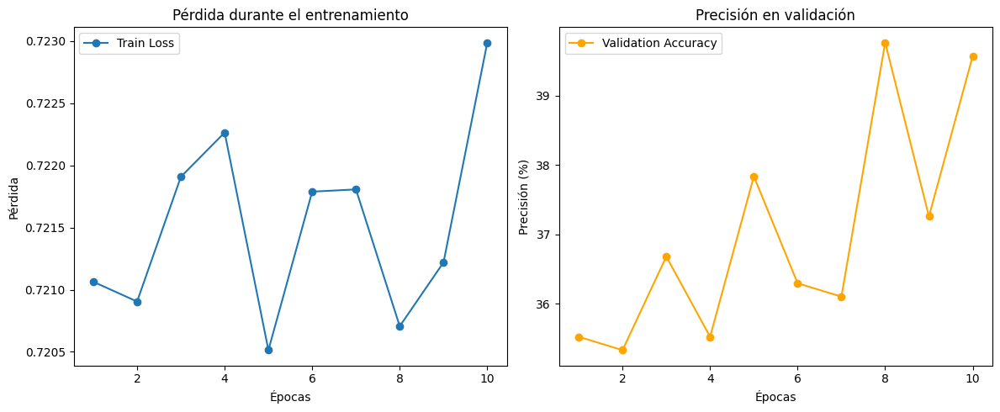

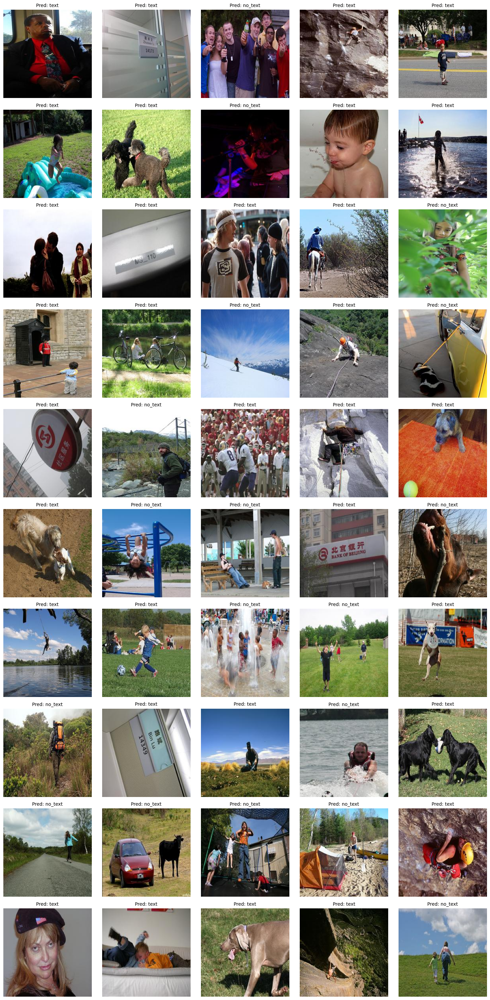

In [11]:
# 4. Entrenar y evaluar el modelo
#    Define un bucle de entrenamiento para
#    actualizar los pesos del modelo usando los datos de entrenamiento.

import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
import torch
from PIL import Image

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

# Inicializar listas para métricas
train_losses = []  # Pérdida promedio en cada época
val_accuracies = []  # Precisión promedio en validación
evaluated_images = []  # Para almacenar imágenes de validación
evaluated_predictions = []  # Para almacenar predicciones de validación

# Entrenamiento y evaluación
num_epochs = 10
for epoch in range(num_epochs):
    # Entrenamiento
    model.train()
# Se usa running_loss para calcular la pérdida promedio:
# Al dividir running_loss por el número total de batches
# (len(train_loader)) para obtener la pérdida promedio al final de la época.
# Esto ayuda a evaluar si el modelo está aprendiendo correctamente
# (la pérdida debería disminuir con el tiempo).
# Seguimiento durante el entrenamiento:
# Si se imprime en cada iteración, puede dar información sobre
# cómo se comporta la pérdida en tiempo real.
# Útil para depuración, pero generalmente se reporta al final de cada época.
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs)  # Forward
        loss = criterion(outputs, labels)  # Calcular pérdida
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    train_losses.append(running_loss / len(train_loader))  # Pérdida promedio de la época

# Evaluación en el conjunto de validación
    model.eval()
    all_labels = []
    all_predictions = []
    evaluated_images.clear()
    evaluated_predictions.clear()
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)  # Forward
            _, predictions = torch.max(outputs, 1)

            # Guardar etiquetas y predicciones
            all_labels.extend(labels.cpu().numpy())
            all_predictions.extend(predictions.cpu().numpy())

            # Guardar imágenes y predicciones para visualización
            if len(evaluated_images) < 50:  # Limitar a 50 imágenes
                evaluated_images.extend(inputs.cpu())
                evaluated_predictions.extend(predictions.cpu().numpy())

    # Calcular precisión
    accuracy = accuracy_score(all_labels, all_predictions)
    val_accuracies.append(accuracy * 100)  # Precisión en porcentaje
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {train_losses[-1]:.4f}, Validation Accuracy: {val_accuracies[-1]:.2f}%")

# --- Graficar métricas ---
plt.figure(figsize=(12, 5))

# Pérdida de entrenamiento
plt.subplot(1, 2, 1)
plt.plot(range(1, len(train_losses) + 1), train_losses, label="Train Loss", marker='o')
plt.xlabel("Épocas")
plt.ylabel("Pérdida")
plt.title("Pérdida durante el entrenamiento")
plt.legend()

# Precisión en validación
plt.subplot(1, 2, 2)
plt.plot(range(1, len(val_accuracies) + 1), val_accuracies, label="Validation Accuracy", color="orange", marker='o')
plt.xlabel("Épocas")
plt.ylabel("Precisión (%)")
plt.title("Precisión en validación")
plt.legend()

plt.tight_layout()
plt.show()

# --- Mostrar imágenes evaluadas ---
def show_image_grid(images, predictions, classes, rows=10, cols=5):
    """
    Muestra un grid de imágenes con sus predicciones.

    Args:
        images: Lista de imágenes (tensores).
        predictions: Lista de predicciones.
        classes: Lista con nombres de las clases.
        rows: Número de filas en el grid.
        cols: Número de columnas en el grid.
    """
    fig, axes = plt.subplots(rows, cols, figsize=(15, 30))
    axes = axes.flatten()

    for img, pred, ax in zip(images[:rows*cols], predictions[:rows*cols], axes):
        # Convertir tensor a imagen y desnormalizar
        img = img.permute(1, 2, 0).numpy()  # Cambiar ejes a (H, W, C)
        img = (img * 0.5) + 0.5  # Desnormalizar
        img = img.clip(0, 1)  # Asegurar rango [0, 1]

        ax.imshow(img)
        ax.set_title(f"Pred: {classes[pred]}", fontsize=10)
        ax.axis('off')

    for ax in axes[len(images):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# Clases del modelo
classes = ['no_text', 'text']

# Mostrar 50 imágenes evaluadas
show_image_grid(evaluated_images, evaluated_predictions, classes, rows=10, cols=5)


In [12]:
# 6. Guardar el modelo entrenado
#    Guarda el modelo fine-tuneado para su uso posterior.
%cd /content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit
torch.save(model.state_dict(), "mobilevit_text_classification_v1.pth")

import os
print(f"Modelo salvado en la ruta: {os.getcwd()}")
!ls

/content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit
Modelo salvado en la ruta: /content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit
app.py	     evaluate.py  __init__.py				perf.yaml    requirements.txt
conftest.py  export.py	  mobilevit_text_classification_v1.pth	__pycache__  test.py
demo.py      info.yaml	  model.py				README.md


Predicción: text


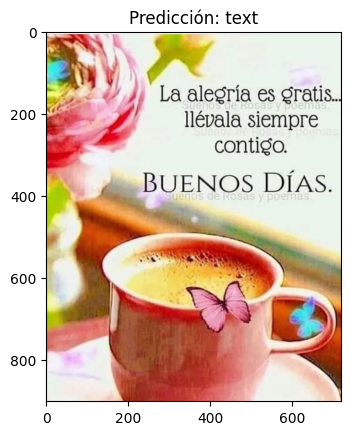

In [13]:
# 7. Mostrar resultados adicionales,
#    como ejemplos de predicciones del modelo sobre nuevas imágenes.

from PIL import Image
import matplotlib.pyplot as plt

# Cargar una imagen de prueba
img_path = "/content/drive/MyDrive/Colab_Notebooks/dataset/images/DescargasdeAmazonPhotos/WhatsAppMensajesMotivacion/IMG-20231119-WA0000.jpg"
img = Image.open(img_path)
img_transformed = transform(img).unsqueeze(0).to(device)  # Preprocesar

# Realizar una predicción
model.eval()
with torch.no_grad():
    output = model(img_transformed)
    _, pred = torch.max(output, 1)

# Mostrar resultado
classes = ['no_text', 'text']
print(f"Predicción: {classes[pred.item()]}")
plt.imshow(img)
plt.title(f"Predicción: {classes[pred.item()]}")
plt.show()


<ipython-input-17-3203a831675d>:12: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("/content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_

Modelo cargado correctamente.
Epoch 1/5, Loss: 0.0107
Epoch 2/5, Loss: 0.0065
Epoch 3/5, Loss: 0.0043
Epoch 4/5, Loss: 0.0016
Epoch 5/5, Loss: 0.0037
Reentrenamiento completado.
Modelo reentrenado y guardado como 'mobilevit_text_classification_v3.pth'
Validation Accuracy: 99.81%


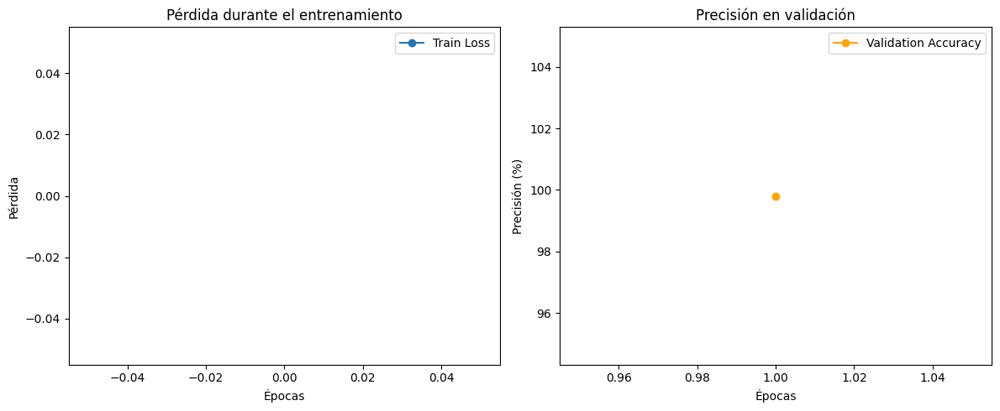

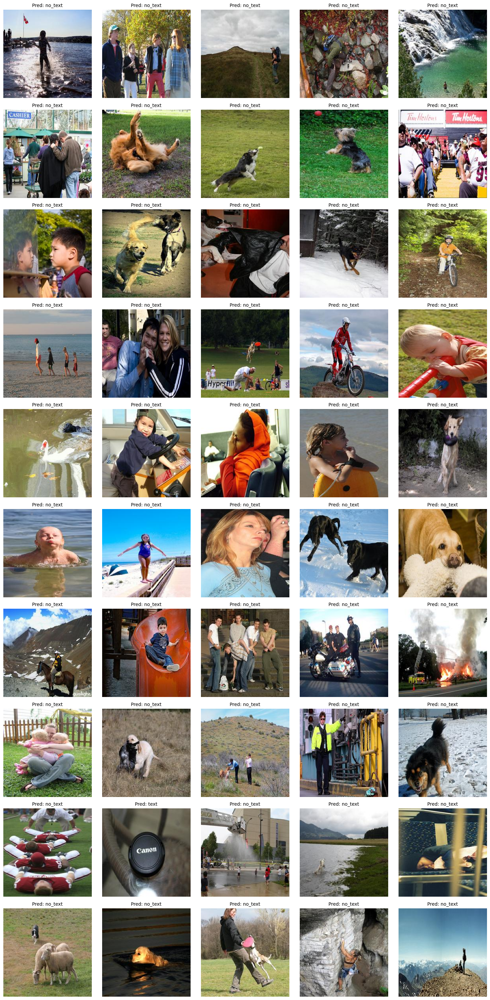

In [17]:
# 1. Configura el modelo entrenado y guardado previamente
#    y carga los pesos guardados para reentrenarlo

from qai_hub_models.models.mobile_vit.model import MobileVIT
import torch

# Configura el modelo
model = MobileVIT.from_pretrained()  # Asegúrate de usar el mismo método de inicialización
model.net.classifier = torch.nn.Linear(model.net.classifier.in_features, 2)  # Ajustar para 2 clases

# Cargar los pesos guardados
model.load_state_dict(torch.load("/content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit/mobilevit_text_classification_v2.pth"))
model.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu'))
print("Modelo cargado correctamente.")

# 2. Preparar los datos
# Si los datos de entrenamiento y validación están configurados como en el
# entrenamiento inicial, se puede reutilizar el pipeline de datos.

from torchvision import datasets, transforms
from torch.utils.data import DataLoader, random_split

# Transformaciones
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# Dataset
dataset_path = "/content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition"
dataset = datasets.ImageFolder(root=dataset_path, transform=transform)

# Dividir en entrenamiento y validación
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Dataloaders
batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

# 3. Configurar el optimizador y la función de pérdida
#    Vuelve a configurar el optimizador y la función de pérdida si necesitas ajustar los hiperparámetros.
import torch.nn as nn
import torch.optim as optim

# Pérdida y optimizador
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)  # Una tasa de aprendizaje más baja es ideal para reentrenamiento

# 4. Reentrenar el modelo
#    Se puede reentrenar el modelo utilizando el mismo bucle de entrenamiento que antes, ajustando el número de épocas.
num_epochs = 5  # Número de épocas adicionales para el reentrenamiento

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu')), labels.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu'))

        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {running_loss/len(train_loader):.4f}")

print("Reentrenamiento completado.")

# 5. Guardar el modelo actualizado
#    Guardar el modelo nuevamente después del reentrenamiento.

torch.save(model.state_dict(), "/content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit/mobilevit_text_classification_v2.pth")
print("Modelo reentrenado y guardado como 'mobilevit_text_classification_v3.pth'")

import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
import torch


# Inicializar listas para métricas
train_losses = []  # Pérdida promedio en entrenamiento
val_accuracies = []  # Precisión promedio en validación
evaluated_images = []  # Imágenes evaluadas
evaluated_predictions = []  # Predicciones asociadas

# 6. Evaluar el modelo en validación y graficar
def evaluate_and_visualize(model, train_losses, val_loader, num_epochs=5):
    """
    Evalúa el modelo en el conjunto de validación y genera métricas gráficas.

    Args:
        model: El modelo entrenado.
        train_losses: Lista con pérdidas promedio por época.
        val_loader: DataLoader del conjunto de validación.
        num_epochs: Número de épocas en el entrenamiento.
    """
    model.eval()
    all_labels = []
    all_predictions = []
    evaluated_images.clear()
    evaluated_predictions.clear()

    # Evaluación del modelo
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            _, predictions = torch.max(outputs, 1)

            # Guardar etiquetas y predicciones
            all_labels.extend(labels.cpu().numpy())
            all_predictions.extend(predictions.cpu().numpy())

            # Guardar imágenes y predicciones para el grid
            if len(evaluated_images) < 50:
                evaluated_images.extend(inputs.cpu())
                evaluated_predictions.extend(predictions.cpu().numpy())

    # Calcular precisión
    accuracy = accuracy_score(all_labels, all_predictions)
    val_accuracies.append(accuracy * 100)
    print(f"Validation Accuracy: {accuracy * 100:.2f}%")

    # --- Graficar métricas ---
    plt.figure(figsize=(12, 5))

    # Pérdida de entrenamiento
    plt.subplot(1, 2, 1)
    plt.plot(range(1, len(train_losses) + 1), train_losses, label="Train Loss", marker='o')
    plt.xlabel("Épocas")
    plt.ylabel("Pérdida")
    plt.title("Pérdida durante el entrenamiento")
    plt.legend()

    # Precisión en validación
    plt.subplot(1, 2, 2)
    plt.plot(range(1, len(val_accuracies) + 1), val_accuracies, label="Validation Accuracy", color="orange", marker='o')
    plt.xlabel("Épocas")
    plt.ylabel("Precisión (%)")
    plt.title("Precisión en validación")
    plt.legend()

    plt.tight_layout()
    plt.show()

# --- Mostrar imágenes evaluadas ---
def show_image_grid(images, predictions, classes, rows=10, cols=5):
    """
    Muestra un grid de imágenes con sus predicciones.

    Args:
        images: Lista de imágenes (tensores).
        predictions: Lista de predicciones.
        classes: Lista con nombres de las clases.
        rows: Número de filas en el grid.
        cols: Número de columnas en el grid.
    """
    fig, axes = plt.subplots(rows, cols, figsize=(15, 30))
    axes = axes.flatten()

    for img, pred, ax in zip(images[:rows*cols], predictions[:rows*cols], axes):
        # Convertir tensor a imagen y desnormalizar
        img = img.permute(1, 2, 0).numpy()  # Cambiar ejes a (H, W, C)
        img = (img * 0.5) + 0.5  # Desnormalizar
        img = img.clip(0, 1)  # Asegurar rango [0, 1]

        ax.imshow(img)
        ax.set_title(f"Pred: {classes[pred]}", fontsize=10)
        ax.axis('off')

    for ax in axes[len(images):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# Llamar a la función de evaluación y visualización
evaluate_and_visualize(model, train_losses, val_loader, num_epochs=10)

# Clases del modelo
classes = ['no_text', 'text']

# Mostrar 50 imágenes evaluadas
show_image_grid(evaluated_images, evaluated_predictions, classes, rows=10, cols=5)


In [18]:
# Posibles causas de la precisión de 99.81% desde la primera época

# El modelo está sobreajustado: En este caso si es pequeño el set.
# Puede ser que el modelo se ajuste demasiado rápido a los datos de entrenamiento,
# lo cual es común si el dataset es pequeño o no lo suficientemente variado.
# La métrica constante desde el inicio también podría indicar que no hay
# suficiente variación en los datos para desafiar al modelo.

# Problemas con el conjunto de validación: En este caso se ha utilizado el mismo set.
# Es posible que el conjunto de validación sea demasiado similar
# al conjunto de entrenamiento.
# Esto sucede si no hubo una separación adecuada entre los datos
# de entrenamiento y validación.

# Problemas en el pipeline de datos: En este caso si estan desbalanceados.
# Si los datos de entrenamiento y validación están desbalanceados,
# es posible que el modelo no aprenda adecuadamente o solo prediga una
# clase dominante.

# Problemas en la evaluación:
# Si las predicciones están siendo comparadas incorrectamente
# (por ejemplo, las clases predichas no coinciden con las clases reales),
# la precisión podría estar sobreestimada.

print("Pérdidas de entrenamiento:", train_losses)
print("Precisión en validación:", val_accuracies)


Pérdidas de entrenamiento: []
Precisión en validación: [99.8069498069498]


In [19]:
# Revisar si los datos están desbalanceados
# Se comprueba la distribución de clases en el dataset.
# Si hay más imágenes de una clase, el modelo podría estar prediciendo
# solo la clase dominante.

from collections import Counter

# Revisar clases en el dataset
train_labels = [label for _, label in train_dataset]
val_labels = [label for _, label in val_dataset]

print("Distribución de clases en entrenamiento:", Counter(train_labels))
print("Distribución de clases en validación:", Counter(val_labels))


Distribución de clases en entrenamiento: Counter({0: 1913, 1: 157})
Distribución de clases en validación: Counter({0: 475, 1: 43})


/usr/local/lib/python3.10/dist-packages/transformers/models/mobilevit/feature_extraction_mobilevit.py:28: FutureWarning: The class MobileViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use MobileViTImageProcessor instead.
  warnings.warn(
<ipython-input-22-cf0e0212a35e>:12: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you 

Modelo cargado correctamente.
Epoch 1/10, Loss: 0.7120, Validation Accuracy: 52.07%
Epoch 2/10, Loss: 0.7131, Validation Accuracy: 54.55%
Epoch 3/10, Loss: 0.7149, Validation Accuracy: 56.20%
Epoch 4/10, Loss: 0.7123, Validation Accuracy: 55.37%
Epoch 5/10, Loss: 0.7130, Validation Accuracy: 54.55%
Epoch 6/10, Loss: 0.7147, Validation Accuracy: 52.89%
Epoch 7/10, Loss: 0.7109, Validation Accuracy: 53.72%
Epoch 8/10, Loss: 0.7142, Validation Accuracy: 52.07%
Epoch 9/10, Loss: 0.7123, Validation Accuracy: 52.89%
Epoch 10/10, Loss: 0.7130, Validation Accuracy: 51.24%


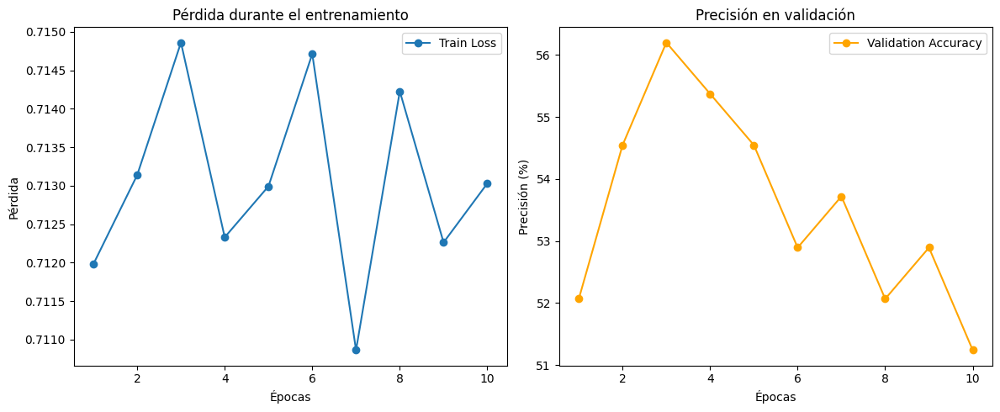

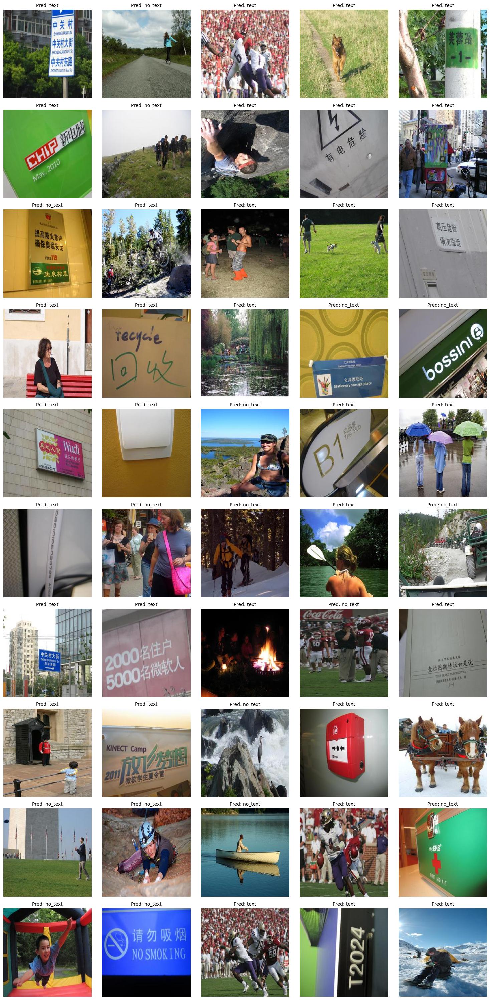

Distribución de clases en entrenamiento: Counter({0: 330, 1: 151})
Distribución de clases en validación: Counter({0: 72, 1: 49})


In [22]:
# 1. Configura el modelo entrenado y guardado previamente
#    y carga los pesos guardados para reentrenarlo

from qai_hub_models.models.mobile_vit.model import MobileVIT
import torch

# Configura el modelo
model = MobileVIT.from_pretrained()  # Asegúrate de usar el mismo método de inicialización
model.net.classifier = torch.nn.Linear(model.net.classifier.in_features, 2)  # Ajustar para 2 clases

# Cargar los pesos guardados
model.load_state_dict(torch.load("/content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit/mobilevit_text_classification_v1.pth"))
model.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu'))
print("Modelo cargado correctamente.")

# 2. Preparar los datos
# Si los datos de entrenamiento y validación están configurados como en el
# entrenamiento inicial, se puede reutilizar el pipeline de datos.

#1. Carga de datos
#   En conjunto de datos esta dividido en dos carpetas: text (con texto) y no_text (sin texto).
#   Usa torchvision.datasets.ImageFolder para cargar estos datos y dividirlos en conjuntos de entrenamiento y validación.

import os
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

# Definir transformaciones para las imágenes
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Este tamaño es requerido por MobileViT, ya que está entrenado con entradas de 224x224 píxeles. Esto asegura que la entrada sea compatible con las dimensiones del modelo.
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))  # Normalización estándar: Este rango normaliza los valores de los píxeles a [-1, 1], que es común en modelos preentrenados como MobileViT, ya que suelen estar entrenados con imágenes normalizadas.
])

# Cargar el dataset con ImageFolder
dataset_path = "/content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition_balanceado"
dataset = datasets.ImageFolder(root=dataset_path, transform=transform)

# Dividir en entrenamiento y validación
from torch.utils.data import random_split

train_size = int(0.8 * len(dataset))  # 80% para entrenamiento
val_size = len(dataset) - train_size  # 20% para validación
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Crear dataloaders
batch_size = 32 #Es un tamaño común para GPUs con memoria moderada (8-16 GB). Si hay más recursos disponibles, puede aumentarse para acelerar el entrenamiento.
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)


# Entrenar y evaluar el modelo
#    Define un bucle de entrenamiento para
#    actualizar los pesos del modelo usando los datos de entrenamiento.

import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
import torch
from PIL import Image

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

# Inicializar listas para métricas
train_losses = []  # Pérdida promedio en cada época
val_accuracies = []  # Precisión promedio en validación
evaluated_images = []  # Para almacenar imágenes de validación
evaluated_predictions = []  # Para almacenar predicciones de validación

# Entrenamiento y evaluación
num_epochs = 10
for epoch in range(num_epochs):
    # Entrenamiento
    model.train()
# Se usa running_loss para calcular la pérdida promedio:
# Al dividir running_loss por el número total de batches
# (len(train_loader)) para obtener la pérdida promedio al final de la época.
# Esto ayuda a evaluar si el modelo está aprendiendo correctamente
# (la pérdida debería disminuir con el tiempo).
# Seguimiento durante el entrenamiento:
# Si se imprime en cada iteración, puede dar información sobre
# cómo se comporta la pérdida en tiempo real.
# Útil para depuración, pero generalmente se reporta al final de cada época.
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs)  # Forward
        loss = criterion(outputs, labels)  # Calcular pérdida
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    train_losses.append(running_loss / len(train_loader))  # Pérdida promedio de la época

# Evaluación en el conjunto de validación
    model.eval()
    all_labels = []
    all_predictions = []
    evaluated_images.clear()
    evaluated_predictions.clear()
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)  # Forward
            _, predictions = torch.max(outputs, 1)

            # Guardar etiquetas y predicciones
            all_labels.extend(labels.cpu().numpy())
            all_predictions.extend(predictions.cpu().numpy())

            # Guardar imágenes y predicciones para visualización
            if len(evaluated_images) < 50:  # Limitar a 50 imágenes
                evaluated_images.extend(inputs.cpu())
                evaluated_predictions.extend(predictions.cpu().numpy())

    # Calcular precisión
    accuracy = accuracy_score(all_labels, all_predictions)
    val_accuracies.append(accuracy * 100)  # Precisión en porcentaje
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {train_losses[-1]:.4f}, Validation Accuracy: {val_accuracies[-1]:.2f}%")

# --- Graficar métricas ---
plt.figure(figsize=(12, 5))

# Pérdida de entrenamiento
plt.subplot(1, 2, 1)
plt.plot(range(1, len(train_losses) + 1), train_losses, label="Train Loss", marker='o')
plt.xlabel("Épocas")
plt.ylabel("Pérdida")
plt.title("Pérdida durante el entrenamiento")
plt.legend()

# Precisión en validación
plt.subplot(1, 2, 2)
plt.plot(range(1, len(val_accuracies) + 1), val_accuracies, label="Validation Accuracy", color="orange", marker='o')
plt.xlabel("Épocas")
plt.ylabel("Precisión (%)")
plt.title("Precisión en validación")
plt.legend()

plt.tight_layout()
plt.show()

# --- Mostrar imágenes evaluadas ---
def show_image_grid(images, predictions, classes, rows=10, cols=5):
    """
    Muestra un grid de imágenes con sus predicciones.

    Args:
        images: Lista de imágenes (tensores).
        predictions: Lista de predicciones.
        classes: Lista con nombres de las clases.
        rows: Número de filas en el grid.
        cols: Número de columnas en el grid.
    """
    fig, axes = plt.subplots(rows, cols, figsize=(15, 30))
    axes = axes.flatten()

    for img, pred, ax in zip(images[:rows*cols], predictions[:rows*cols], axes):
        # Convertir tensor a imagen y desnormalizar
        img = img.permute(1, 2, 0).numpy()  # Cambiar ejes a (H, W, C)
        img = (img * 0.5) + 0.5  # Desnormalizar
        img = img.clip(0, 1)  # Asegurar rango [0, 1]

        ax.imshow(img)
        ax.set_title(f"Pred: {classes[pred]}", fontsize=10)
        ax.axis('off')

    for ax in axes[len(images):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# Clases del modelo
classes = ['no_text', 'text']

# Mostrar 50 imágenes evaluadas
show_image_grid(evaluated_images, evaluated_predictions, classes, rows=10, cols=5)

# Revisar si los datos están desbalanceados
# Se comprueba la distribución de clases en el dataset.
# Balanceamos set de datos y comprobamos de nuevo

from collections import Counter

# Revisar clases en el dataset
train_labels = [label for _, label in train_dataset]
val_labels = [label for _, label in val_dataset]

print("Distribución de clases en entrenamiento:", Counter(train_labels))
print("Distribución de clases en validación:", Counter(val_labels))

In [23]:
# Guardar el modelo entrenado
#    Guarda el modelo fine-tuneado para su uso posterior.
%cd /content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit
torch.save(model.state_dict(), "mobilevit_text_classification_v2.pth")

import os
print(f"Modelo salvado en la ruta: {os.getcwd()}")
!ls

/content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit
Modelo salvado en la ruta: /content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit
app.py	     evaluate.py  __init__.py				model.py     README.md
conftest.py  export.py	  mobilevit_text_classification_v1.pth	perf.yaml    requirements.txt
demo.py      info.yaml	  mobilevit_text_classification_v2.pth	__pycache__  test.py


/usr/local/lib/python3.10/dist-packages/transformers/models/mobilevit/feature_extraction_mobilevit.py:28: FutureWarning: The class MobileViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use MobileViTImageProcessor instead.
  warnings.warn(
<ipython-input-24-3e44732073a2>:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you 

Modelo cargado correctamente.
Epoch 1/10, Loss: 0.7100, Validation Accuracy: 42.98%
Epoch 2/10, Loss: 0.7107, Validation Accuracy: 43.80%
Epoch 3/10, Loss: 0.7090, Validation Accuracy: 47.93%
Epoch 4/10, Loss: 0.7136, Validation Accuracy: 39.67%
Epoch 5/10, Loss: 0.7167, Validation Accuracy: 42.15%
Epoch 6/10, Loss: 0.7130, Validation Accuracy: 46.28%
Epoch 7/10, Loss: 0.7114, Validation Accuracy: 42.98%
Epoch 8/10, Loss: 0.7120, Validation Accuracy: 48.76%
Epoch 9/10, Loss: 0.7149, Validation Accuracy: 44.63%
Epoch 10/10, Loss: 0.7118, Validation Accuracy: 47.11%


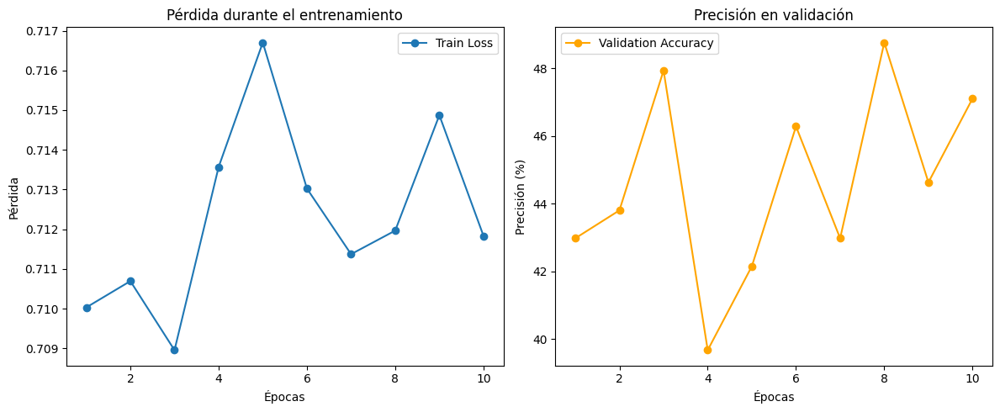

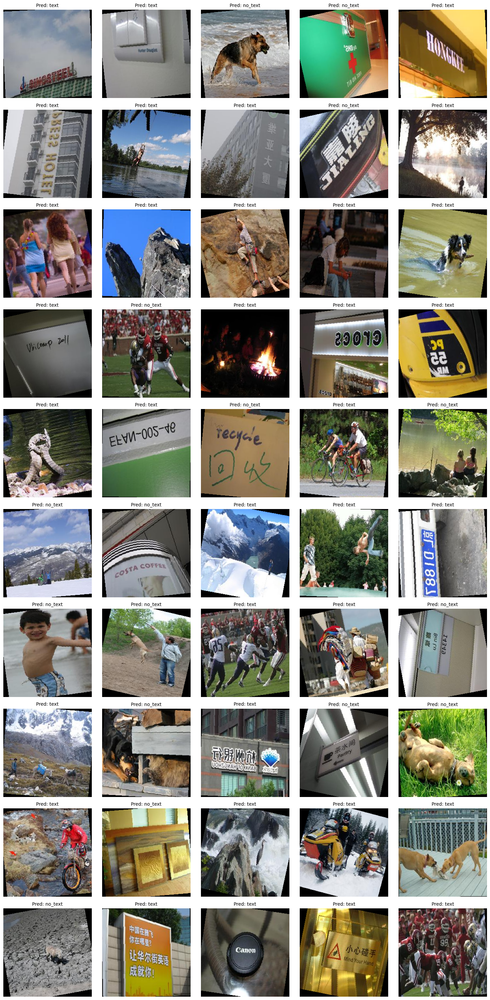

/content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit
Modelo salvado en la ruta: /content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit
app.py	     evaluate.py  __init__.py				model.py     README.md
conftest.py  export.py	  mobilevit_text_classification_v1.pth	perf.yaml    requirements.txt
demo.py      info.yaml	  mobilevit_text_classification_v2.pth	__pycache__  test.py
Distribución de clases en entrenamiento: Counter({0: 324, 1: 157})
Distribución de clases en validación: Counter({0: 78, 1: 43})


In [24]:
# 1. Configura el modelo entrenado y guardado previamente
#    y carga los pesos guardados para reentrenarlo,
#    con augmentacion de datos y balanceo de dataset

from qai_hub_models.models.mobile_vit.model import MobileVIT
import torch

# Configura el modelo
model = MobileVIT.from_pretrained()  # Asegúrate de usar el mismo método de inicialización
model.net.classifier = torch.nn.Linear(model.net.classifier.in_features, 2)  # Ajustar para 2 clases

# Cargar los pesos guardados
model.load_state_dict(torch.load("/content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit/mobilevit_text_classification_v1.pth"))
model.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu'))
print("Modelo cargado correctamente.")

# 2. Preparar los datos
# Si los datos de entrenamiento y validación están configurados como en el
# entrenamiento inicial, se puede reutilizar el pipeline de datos.

#1. Carga de datos
#   En conjunto de datos esta dividido en dos carpetas: text (con texto) y no_text (sin texto).
#   Usa torchvision.datasets.ImageFolder para cargar estos datos y dividirlos en conjuntos de entrenamiento y validación.

import os
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

# Definir transformaciones para las imágenes con augmentacion
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),  # Aumentos de datos - Volteo horizontal aleatorio
    transforms.RandomRotation(15),  # Aumentos de datos - Rotación aleatoria
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# Cargar el dataset con ImageFolder
dataset_path = "/content/drive/MyDrive/Colab_Notebooks/dataset/text_recognition_balanceado"
dataset = datasets.ImageFolder(root=dataset_path, transform=transform)

# Dividir en entrenamiento y validación
from torch.utils.data import random_split

train_size = int(0.8 * len(dataset))  # 80% para entrenamiento
val_size = len(dataset) - train_size  # 20% para validación
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Crear dataloaders
batch_size = 32 #Es un tamaño común para GPUs con memoria moderada (8-16 GB). Si hay más recursos disponibles, puede aumentarse para acelerar el entrenamiento.
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)


# Entrenar y evaluar el modelo
#    Define un bucle de entrenamiento para
#    actualizar los pesos del modelo usando los datos de entrenamiento.

import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
import torch
from PIL import Image

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)

# Inicializar listas para métricas
train_losses = []  # Pérdida promedio en cada época
val_accuracies = []  # Precisión promedio en validación
evaluated_images = []  # Para almacenar imágenes de validación
evaluated_predictions = []  # Para almacenar predicciones de validación

# Entrenamiento y evaluación
num_epochs = 10
for epoch in range(num_epochs):
    # Entrenamiento
    model.train()
# Se usa running_loss para calcular la pérdida promedio:
# Al dividir running_loss por el número total de batches
# (len(train_loader)) para obtener la pérdida promedio al final de la época.
# Esto ayuda a evaluar si el modelo está aprendiendo correctamente
# (la pérdida debería disminuir con el tiempo).
# Seguimiento durante el entrenamiento:
# Si se imprime en cada iteración, puede dar información sobre
# cómo se comporta la pérdida en tiempo real.
# Útil para depuración, pero generalmente se reporta al final de cada época.
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs)  # Forward
        loss = criterion(outputs, labels)  # Calcular pérdida
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    train_losses.append(running_loss / len(train_loader))  # Pérdida promedio de la época

# Evaluación en el conjunto de validación
    model.eval()
    all_labels = []
    all_predictions = []
    evaluated_images.clear()
    evaluated_predictions.clear()
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)  # Forward
            _, predictions = torch.max(outputs, 1)

            # Guardar etiquetas y predicciones
            all_labels.extend(labels.cpu().numpy())
            all_predictions.extend(predictions.cpu().numpy())

            # Guardar imágenes y predicciones para visualización
            if len(evaluated_images) < 50:  # Limitar a 50 imágenes
                evaluated_images.extend(inputs.cpu())
                evaluated_predictions.extend(predictions.cpu().numpy())

    # Calcular precisión
    accuracy = accuracy_score(all_labels, all_predictions)
    val_accuracies.append(accuracy * 100)  # Precisión en porcentaje
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {train_losses[-1]:.4f}, Validation Accuracy: {val_accuracies[-1]:.2f}%")

# --- Graficar métricas ---
plt.figure(figsize=(12, 5))

# Pérdida de entrenamiento
plt.subplot(1, 2, 1)
plt.plot(range(1, len(train_losses) + 1), train_losses, label="Train Loss", marker='o')
plt.xlabel("Épocas")
plt.ylabel("Pérdida")
plt.title("Pérdida durante el entrenamiento")
plt.legend()

# Precisión en validación
plt.subplot(1, 2, 2)
plt.plot(range(1, len(val_accuracies) + 1), val_accuracies, label="Validation Accuracy", color="orange", marker='o')
plt.xlabel("Épocas")
plt.ylabel("Precisión (%)")
plt.title("Precisión en validación")
plt.legend()

plt.tight_layout()
plt.show()

# --- Mostrar imágenes evaluadas ---
def show_image_grid(images, predictions, classes, rows=10, cols=5):
    """
    Muestra un grid de imágenes con sus predicciones.

    Args:
        images: Lista de imágenes (tensores).
        predictions: Lista de predicciones.
        classes: Lista con nombres de las clases.
        rows: Número de filas en el grid.
        cols: Número de columnas en el grid.
    """
    fig, axes = plt.subplots(rows, cols, figsize=(15, 30))
    axes = axes.flatten()

    for img, pred, ax in zip(images[:rows*cols], predictions[:rows*cols], axes):
        # Convertir tensor a imagen y desnormalizar
        img = img.permute(1, 2, 0).numpy()  # Cambiar ejes a (H, W, C)
        img = (img * 0.5) + 0.5  # Desnormalizar
        img = img.clip(0, 1)  # Asegurar rango [0, 1]

        ax.imshow(img)
        ax.set_title(f"Pred: {classes[pred]}", fontsize=10)
        ax.axis('off')

    for ax in axes[len(images):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# Clases del modelo
classes = ['no_text', 'text']

# Mostrar 50 imágenes evaluadas
show_image_grid(evaluated_images, evaluated_predictions, classes, rows=10, cols=5)

# Guardar el modelo entrenado
#    Guarda el modelo fine-tuneado para su uso posterior.
%cd /content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit
torch.save(model.state_dict(), "mobilevit_text_classification_v2.pth")

import os
print(f"Modelo salvado en la ruta: {os.getcwd()}")
!ls

# Revisar si los datos están desbalanceados
# Se comprueba la distribución de clases en el dataset.
# Balanceamos set de datos y comprobamos de nuevo

from collections import Counter

# Revisar clases en el dataset
train_labels = [label for _, label in train_dataset]
val_labels = [label for _, label in val_dataset]

print("Distribución de clases en entrenamiento:", Counter(train_labels))
print("Distribución de clases en validación:", Counter(val_labels))

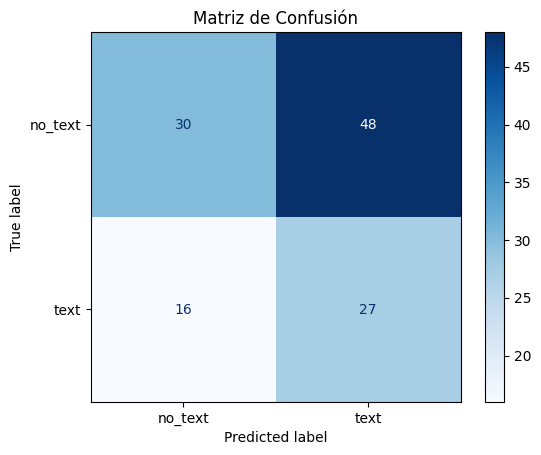

In [26]:
# Se usa una matriz de confusión para visualizar cómo el modelo
# clasifica las imágenes

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Matriz de confusión
cm = confusion_matrix(all_labels, all_predictions)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=classes)
disp.plot(cmap=plt.cm.Blues)
plt.title("Matriz de Confusión")
plt.show()


# Matriz de confusión
La matriz de confusión proporciona un análisis detallado del rendimiento del modelo en términos de clasificaciones correctas e incorrectas para las clases no_text y text.

## Interpretación de la Matriz de Confusión

###Ejes de la matriz:
El eje vertical representa las etiquetas reales del conjunto de validación.
El eje horizontal representa las predicciones del modelo.

###Valores en la matriz:
(30): Cantidad de imágenes correctamente clasificadas como no_text.
(27): Cantidad de imágenes correctamente clasificadas como text.
(48): Cantidad de imágenes clasificadas incorrectamente como text cuando eran no_text.
(16): Cantidad de imágenes clasificadas incorrectamente como no_text cuando eran text.

##Análisis del Modelo

###Rendimiento general:
El modelo muestra un rendimiento moderado, ya que hay muchas clasificaciones incorrectas, especialmente para la clase no_text.

###Errores predominantes:
El modelo confunde frecuentemente imágenes de no_text como text (48 casos).

Esto podría deberse a similitudes visuales entre las clases, falta de información distintiva en las características de la clase no_text, tambien a que los transformers no tienen buen rendimiento con conjuntos de datos pequeños, como ya hemos consultado en las investigaciones sobre Transformers como "Attetion is all you need"(Vaswani et al., 2023)

Clasificaciones correctas:
57 imágenes clasificadas correctamente:
no_text: 30 correctas.
text: 27 correctas.

Tasa de error:
Errores totales:
48 (falsos positivos) + 16 (falsos negativos) = 64 errores.

Precisión del modelo= correctas/total
Precisión del modelo = 57/121 ≈ 47.1%

Esto sugiere que el modelo tiene dificultades para generalizar.

/usr/local/lib/python3.10/dist-packages/transformers/models/mobilevit/feature_extraction_mobilevit.py:28: FutureWarning: The class MobileViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use MobileViTImageProcessor instead.
  warnings.warn(
<ipython-input-29-e523469d4127>:17: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you 

Modelo cargado correctamente.


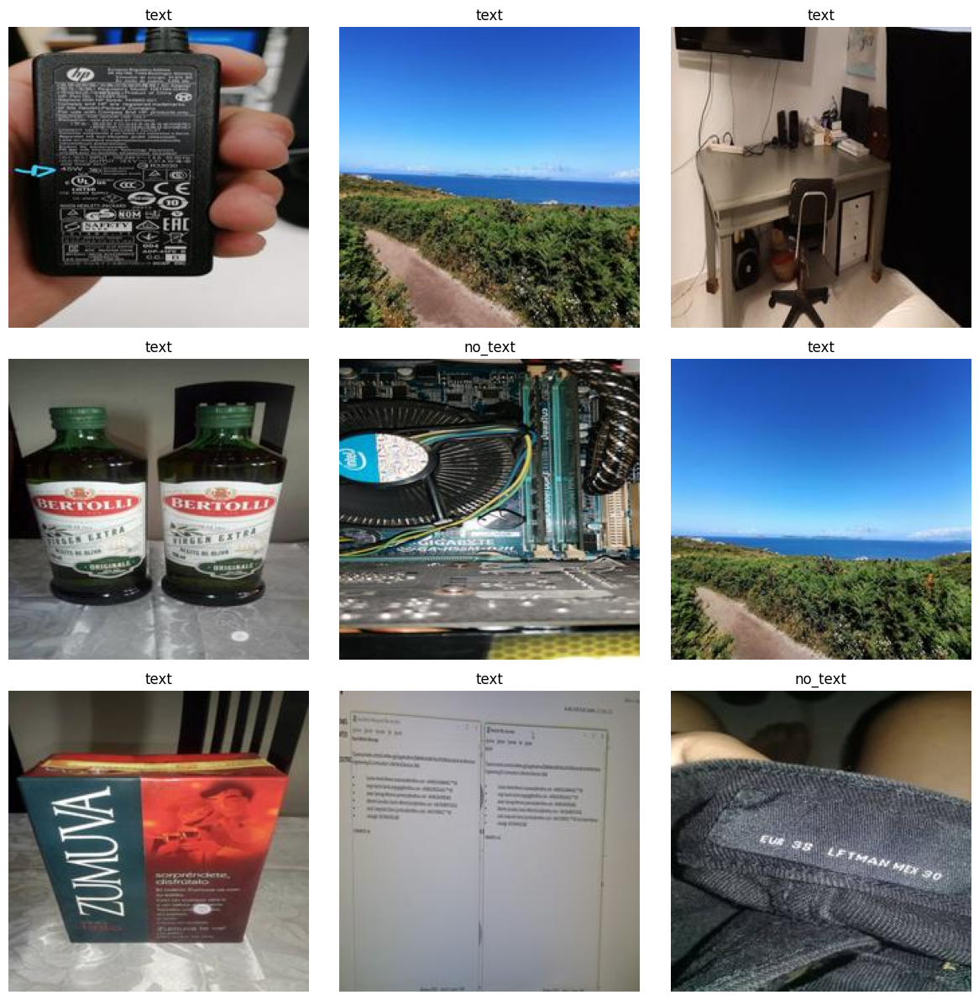

In [29]:
# INFERENCIA DEL MODELO

import os
from PIL import Image
import matplotlib.pyplot as plt
import torch
from torchvision import transforms

from qai_hub_models.models.mobile_vit.model import MobileVIT

# Configura el modelo
model = MobileVIT.from_pretrained()  # Asegúrate de usar el mismo método de inicialización
model.net.classifier = torch.nn.Linear(model.net.classifier.in_features, 2)  # Ajustar para 2 clases

# Cargar los pesos guardados
model.load_state_dict(torch.load("/content/drive/MyDrive/Colab_Notebooks/ai-hub-models/qai_hub_models/models/mobile_vit/mobilevit_text_classification_v1.pth"))
model.to(torch.device('cuda' if torch.cuda.is_available() else 'cpu'))
print("Modelo cargado correctamente.")

# Transformaciones para preprocesar imágenes
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))  # Ajustar según tu modelo
])

# Clases del modelo
classes = ['no_text', 'text']

# Función para evaluar imágenes en un directorio
def evaluate_images_in_directory(model, directory_path, device, max_images=9):
    """
    Evalúa todas las imágenes en un directorio y muestra un grid con las predicciones del modelo.

    Args:
        model: Modelo entrenado para evaluación.
        directory_path: Ruta al directorio con imágenes.
        device: Dispositivo (CPU/GPU) en el que correr el modelo.
        max_images: Número máximo de imágenes a mostrar en el grid (default: 9).
    """
    # Obtener la lista de imágenes en el directorio
    image_paths = [os.path.join(directory_path, f) for f in os.listdir(directory_path) if f.endswith(('png', 'jpg', 'jpeg'))]

    if not image_paths:
        print("No se encontraron imágenes en el directorio.")
        return

    # Limitar al número máximo de imágenes
    image_paths = image_paths[:max_images]

    model.eval()  # Poner el modelo en modo evaluación
    images = []
    predictions = []

    with torch.no_grad():
        for img_path in image_paths:
            # Cargar y preprocesar cada imagen
            img = Image.open(img_path).convert('RGB')
            img_transformed = transform(img).unsqueeze(0).to(device)

            # Predicción del modelo
            output = model(img_transformed)
            _, pred = torch.max(output, 1)

            # Guardar imagen y predicción
            images.append(img)
            predictions.append(classes[pred.item()])

    # Mostrar las imágenes en un grid
    show_image_grid(images, predictions)

# Función para mostrar un grid de imágenes con títulos
def show_image_grid(images, titles, rows=3, cols=3):
    """
    Muestra un grid de imágenes con títulos.

    Args:
        images: Lista de imágenes (PIL Images).
        titles: Lista de títulos para cada imagen.
        rows: Número de filas en el grid.
        cols: Número de columnas en el grid.
    """
    fig, axes = plt.subplots(rows, cols, figsize=(12, 12))
    axes = axes.flatten()

    for img, title, ax in zip(images, titles, axes):
        ax.imshow(img)
        ax.set_title(title, fontsize=12)
        ax.axis('off')

    # Ocultar los ejes adicionales si hay menos imágenes que slots
    for ax in axes[len(images):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# Ruta al directorio con imágenes
directory_path = "/content/drive/MyDrive/Colab_Notebooks/dataset/images/DescargasdeAmazonPhotos/WhatsAppImagesPruebaTexto"

# Evaluar y mostrar resultados
evaluate_images_in_directory(model, directory_path, device, max_images=9)


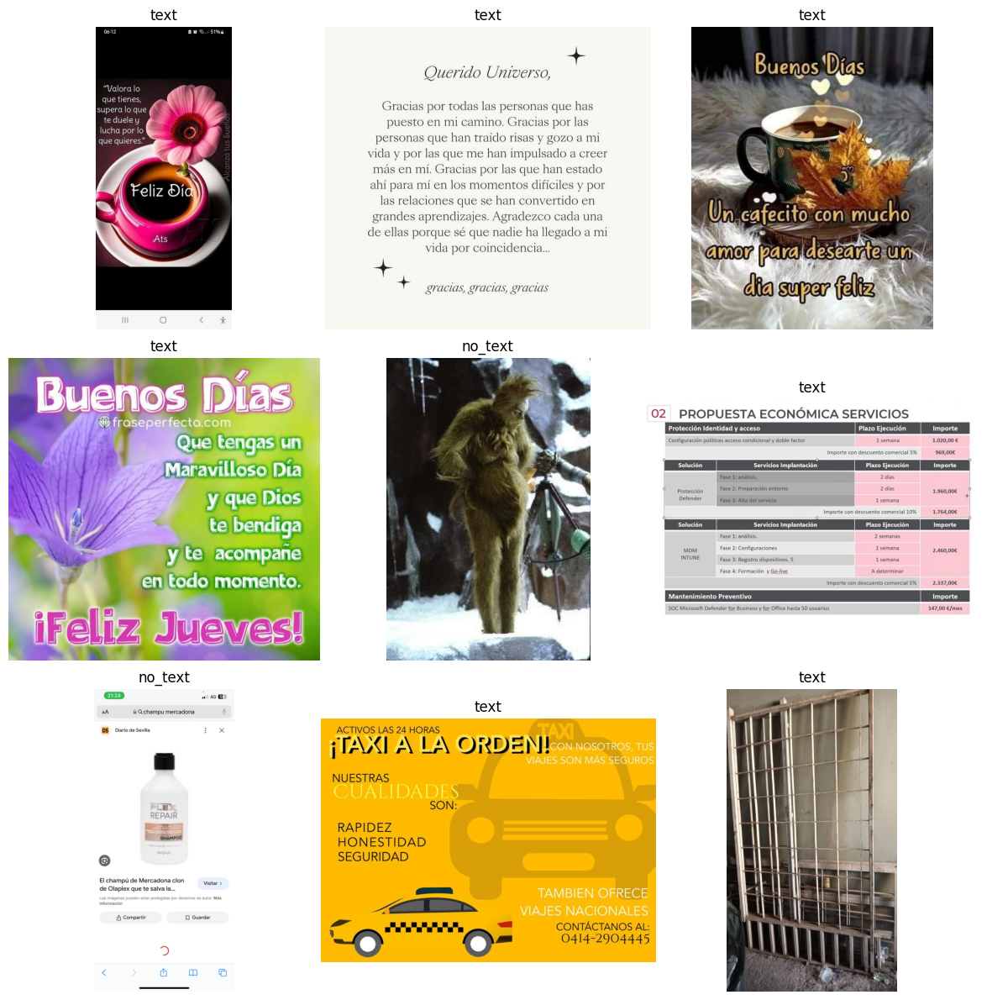

In [5]:
# Código para evaluar todas las imágenes de un directorio y
# mostrar un grid de imágenes con sus clasificaciones usando el
# modelo CLIP de la biblioteca transformers

from transformers import CLIPProcessor, CLIPModel
import torch
from PIL import Image
import matplotlib.pyplot as plt
import os

# Inicializar el modelo y el procesador CLIP
model_name = "openai/clip-vit-base-patch32"
model = CLIPModel.from_pretrained(model_name)
processor = CLIPProcessor.from_pretrained(model_name)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Clases objetivo (puedes ajustar según tu caso)
classes = ["text", "no_text"]

# Función para evaluar imágenes en un directorio usando CLIP
def evaluate_images_with_clip(model, processor, directory_path, device, max_images=9):
    """
    Evalúa todas las imágenes en un directorio y muestra un grid con las predicciones de CLIP.

    Args:
        model: Modelo CLIP preentrenado.
        processor: Procesador asociado al modelo CLIP.
        directory_path: Ruta al directorio con imágenes.
        device: Dispositivo (CPU/GPU) en el que correr el modelo.
        max_images: Número máximo de imágenes a mostrar en el grid (default: 9).
    """
    # Obtener la lista de imágenes en el directorio
    image_paths = [os.path.join(directory_path, f) for f in os.listdir(directory_path) if f.endswith(('png', 'jpg', 'jpeg'))]

    if not image_paths:
        print("No se encontraron imágenes en el directorio.")
        return

    # Limitar al número máximo de imágenes
    image_paths = image_paths[:max_images]

    images = []
    predictions = []

    model.eval()  # Modo evaluación
    with torch.no_grad():
        for img_path in image_paths:
            # Cargar la imagen y procesarla
            img = Image.open(img_path).convert("RGB")
            inputs = processor(images=img, return_tensors="pt", padding=True).to(device)

            # Obtener características de texto
            text_inputs = processor(text=classes, return_tensors="pt", padding=True).to(device)

            # Realizar la inferencia con CLIP
            image_features = model.get_image_features(**inputs)
            text_features = model.get_text_features(**text_inputs)

            # Calcular similitud entre imagen y texto
            logits_per_image = image_features @ text_features.T
            probs = logits_per_image.softmax(dim=1)  # Convertir a probabilidades

            # Guardar la imagen y la predicción
            pred_class = classes[torch.argmax(probs).item()]
            images.append(img)
            predictions.append(pred_class)

    # Mostrar las imágenes en un grid
    show_image_grid(images, predictions)


# Función para mostrar un grid de imágenes con títulos
def show_image_grid(images, titles, rows=3, cols=3):
    """
    Muestra un grid de imágenes con títulos.

    Args:
        images: Lista de imágenes (PIL Images).
        titles: Lista de títulos para cada imagen.
        rows: Número de filas en el grid.
        cols: Número de columnas en el grid.
    """
    fig, axes = plt.subplots(rows, cols, figsize=(12, 12))
    axes = axes.flatten()

    for img, title, ax in zip(images, titles, axes):
        ax.imshow(img)
        ax.set_title(title, fontsize=12)
        ax.axis('off')

    # Ocultar los ejes adicionales si hay menos imágenes que slots
    for ax in axes[len(images):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# Ruta al directorio con imágenes
directory_path = "/content/drive/MyDrive/Colab_Notebooks/dataset/images/DescargasdeAmazonPhotos/WhatsAppImagesPruebaTexto"

# Evaluar y mostrar resultados
evaluate_images_with_clip(model, processor, directory_path, device, max_images=9)


In [7]:
def compare_models(clip_model, mobilevit_model, processor, transform, directory_path, device, max_images=9):
    """
    Compara MobileViT y CLIP clasificando imágenes desde un directorio y muestra un grid con ambas predicciones.

    Args:
        clip_model: Modelo CLIP preentrenado.
        mobilevit_model: Modelo MobileViT entrenado.
        processor: Procesador de CLIP.
        transform: Transformación para preprocesar imágenes para MobileViT.
        directory_path: Ruta al directorio con imágenes.
        device: Dispositivo (CPU/GPU).
        max_images: Número máximo de imágenes a procesar (default: 9).
    """
    # Obtener imágenes del directorio
    image_paths = [os.path.join(directory_path, f) for f in os.listdir(directory_path) if f.endswith(('png', 'jpg', 'jpeg'))]

    if not image_paths:
        print("No se encontraron imágenes en el directorio.")
        return

    image_paths = image_paths[:max_images]  # Limitar a `max_images`
    images = []
    clip_predictions = []
    mobilevit_predictions = []

    # Clases para MobileViT y CLIP
    classes = ['no_text', 'text']

    # Modo evaluación para ambos modelos
    clip_model.eval()
    mobilevit_model.eval()

    with torch.no_grad():
        for img_path in image_paths:
            # Cargar y procesar la imagen
            img = Image.open(img_path).convert("RGB")
            images.append(img)

            # Predicción con CLIP
            clip_inputs = processor(images=img, return_tensors="pt").to(device)
            text_inputs = processor(text=classes, return_tensors="pt", padding=True).to(device)
            clip_image_features = clip_model.get_image_features(**clip_inputs)
            clip_text_features = clip_model.get_text_features(**text_inputs)
            clip_logits = clip_image_features @ clip_text_features.T
            clip_pred_class = classes[torch.argmax(clip_logits.softmax(dim=1)).item()]
            clip_predictions.append(clip_pred_class)

            # Predicción con MobileViT
            mobilevit_input = transform(img).unsqueeze(0).to(device)
            mobilevit_output = mobilevit_model(mobilevit_input)
            _, mobilevit_pred = torch.max(mobilevit_output, 1)
            mobilevit_predictions.append(classes[mobilevit_pred.item()])

    # Mostrar los resultados en un grid
    show_comparison_grid(images, clip_predictions, mobilevit_predictions)

def show_comparison_grid(images, clip_preds, mobilevit_preds, rows=3, cols=3):
    """
    Muestra un grid de imágenes con las predicciones de CLIP y MobileViT.

    Args:
        images: Lista de imágenes (PIL).
        clip_preds: Predicciones de CLIP.
        mobilevit_preds: Predicciones de MobileViT.
        rows: Número de filas en el grid.
        cols: Número de columnas en el grid.
    """
    fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
    axes = axes.flatten()

    for img, clip_pred, mobilevit_pred, ax in zip(images, clip_preds, mobilevit_preds, axes):
        ax.imshow(img)
        title = f"CLIP: {clip_pred}\nMobileViT: {mobilevit_pred}"
        ax.set_title(title, fontsize=10)
        ax.axis('off')

    # Ocultar ejes sobrantes
    for ax in axes[len(images):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

# Ejemplo de uso
directory_path = "/content/drive/MyDrive/Colab_Notebooks/dataset/images/DescargasdeAmazonPhotos/WhatsAppImagesPruebaTexto"
compare_models(clip_model, mobilevit_model, processor, transform, directory_path, device, max_images=9)


NameError: name 'clip_model' is not defined

In [8]:
# Redimensionado del set de imagenes
# Directorio de entrada y salida

from PIL import Image
import os

def resize_images(input_dir, output_dir, size=(224, 224)):
    """
    Redimensiona todas las imágenes en un directorio a una resolución específica y las guarda en otro directorio.

    Args:
        input_dir (str): Ruta al directorio con las imágenes originales.
        output_dir (str): Ruta al directorio donde se guardarán las imágenes redimensionadas.
        size (tuple): Resolución deseada (ancho, alto), por defecto (256, 256).
    """
    # Crear el directorio de salida si no existe
    os.makedirs(output_dir, exist_ok=True)

    # Iterar sobre todas las imágenes en el directorio de entrada
    for filename in os.listdir(input_dir):
        input_path = os.path.join(input_dir, filename)
        output_path = os.path.join(output_dir, filename)

        # Verificar si el archivo es una imagen (extensiones comunes)
        if filename.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp', '.gif')):
            try:
                # Abrir, redimensionar y guardar la imagen
                with Image.open(input_path) as img:
                    img = img.convert("RGB")  # Convertir a RGB si no está en este formato
                    img = img.resize(size, Image.Resampling.LANCZOS)  # Redimensionar con suavizado
                    img.save(output_path)
                print(f"Imagen redimensionada y guardada: {output_path}")
            except Exception as e:
                print(f"Error al procesar {input_path}: {e}")

# Directorio de entrada y salida
input_directory = "/content/drive/MyDrive/Colab_Notebooks/dataset/images/DescargasdeAmazonPhotos/WhatsAppImages"
output_directory = "/content/drive/MyDrive/Colab_Notebooks/dataset/images/DescargasdeAmazonPhotos/WhatsAppImages224"

# Ajustar resolución de las imágenes
resize_images(input_directory, output_directory, size=(224, 224))




Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/images/DescargasdeAmazonPhotos/WhatsAppImages224/IMG-20220709-WA0003.jpg
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/images/DescargasdeAmazonPhotos/WhatsAppImages224/IMG-20220711-WA0002.jpg
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/images/DescargasdeAmazonPhotos/WhatsAppImages224/IMG-20220712-WA0002.jpg
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/images/DescargasdeAmazonPhotos/WhatsAppImages224/IMG-20220712-WA0004.jpg
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/images/DescargasdeAmazonPhotos/WhatsAppImages224/IMG-20220712-WA0005.jpg
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dataset/images/DescargasdeAmazonPhotos/WhatsAppImages224/IMG-20220712-WA0008.jpg
Imagen redimensionada y guardada: /content/drive/MyDrive/Colab_Notebooks/dat

# Implementación del modelo compilado en Android

Los modelos se pueden implementar utilizando múltiples tiempos de ejecución, al exportarlos con TensorFlow Lite (.tflite export)

Este tutorial proporciona una guía para implementar el modelo tflite en una aplicación de Android:

https://ai.google.dev/edge/litert/android?hl=es-419